# Application of cubic spline regression to VBA encoder data
Doug Ollerenshaw  
dougo@alleninstistute.org  
7/8/2020  

Encoder data on Visual Behavior data acquisition rigs is prone to measurement noise, as documented here:
    https://gist.github.com/dougollerenshaw/4af2863494e503d2ab0d56f84ea5f25a  
        
While various filtering methods can be applied to the data to smooth it, we want to avoid fundamentally changing the shape of the running trajectory in a way that could affect interpretation of the results.  

Therefore, instead of filtering the data, we have decided to take the approach of fitting cubic splines to the raw voltage data. This will allow the smoothed curves to follow the raw data without any specific constraints on frequency content. 

The key parameter to choose is the number of 'knots', or spline junctions. At the limit, setting the number of knots equal to the number of data points will allow the splines to fully fit the raw data. Setting the number of knots to some factor, `F`, of the total number of data points will allow the splines to approximate the data to varying degrees. Fewer knots will avoid fitting high frequency components and will converge faster at the expense of the quality of the fit.

What follows is code to apply cubic spline regression to the encoder voltage data, as well as example results for a single short section of true running data for a range of `F` values, where `F` defines the number of knots (`K`) as:

$$K = N/F$$
    
where `N` is the total number of data points

## Imports

In [1]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

import visual_behavior.database as db
import imageio

from sklearn import linear_model
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.base import BaseEstimator, TransformerMixin

In [2]:
%matplotlib notebook

## set to widescreen mode
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

# Define functions`

In [3]:
def identify_wraps(row,lower_threshold=1.5,upper_threshold=3.5):
    '''
    identify "wraps" in the voltage signal as any point where the crosses from 5V to 0V or vice-versa
    '''
    if row['v_sig'] < lower_threshold and row['v_sig_last'] > upper_threshold:
        return 1 # positive wrap
    elif row['v_sig'] > upper_threshold and row['v_sig_last'] < lower_threshold:
        return -1 # negative wrap
    else:
        return 0

def calculate_wrap_corrected_diff(row, max_diff = 1, nan_transitions=False):
    '''
    calculate the change in voltage at each timestep, accounting for the wraps.
    '''
    if row['wrap_ID'] == 1:
        # unrwap the current value, subtract the last valueif nan_transitions:
        if nan_transitions:
            diff = np.nan
        else:
            diff = (row['v_sig'] + row['v_in']) - row['v_sig_last']
    elif row['wrap_ID'] == -1:
        # unwrap the last value, subtract it from the current value
        if nan_transitions:
            diff = np.nan
        else:
            diff = row['v_sig'] - (row['v_sig_last'] + row['v_in'])
    else:
        diff = row['v_sig'] - row['v_sig_last']
        
    if np.abs(diff) > max_diff:
        return np.nan
    else:
        return diff

In [4]:
def add_columns_and_unwrap(df):
    '''
    add columns to the running dataframe representing:
        v_sig_last: shifted voltage signal
        wrap_ID: 1 for postive wraps, -1 for negative wraps, 0 otherwise
        v_sig_diff: voltage derivative, after accounting for wraps
        v_sig_unwrapped: the cumulative voltage signal (no longer bounded by 0 to 5V)
    '''
    df['v_sig_last'] = df['v_sig'].shift()
    df['wrap_ID'] = df.apply(identify_wraps,axis=1)
    df['v_sig_diff'] = df.apply(calculate_wrap_corrected_diff,axis=1,nan_transitions=False)
    df['v_sig_unwrapped'] = np.cumsum(df['v_sig_diff']) + df['v_sig'].iloc[0]
    
    return df

In [5]:
def calculate_derivative(df,column_to_differentiate,time_column='time'):
    '''a simple derivative function'''
    return np.gradient(df[column_to_differentiate],df[time_column])

In [6]:
def calculate_speed(df,voltage_column,time_column='time'):
    '''a function to calculate speed from the voltage signal'''
    delta_theta = df[voltage_column].diff()/df['v_in']*2*np.pi # delta theta at each step in radians

    wheel_diameter = 6.5 * 2.54  # 6.5" wheel diameter
    running_radius = 0.5 * (2.0 * wheel_diameter / 3.0)  # assume the animal runs at 2/3 the distance from the wheel center
    
    df_temp = pd.DataFrame({'time':df[time_column],'theta_cumulative':np.cumsum(delta_theta)})
    
    speed = calculate_derivative(df_temp, column_to_differentiate='theta_cumulative', time_column=time_column) * running_radius # linear speed in cm/s
    
    return speed
    

### a set of functions for fitting cubic splines to the data

In [7]:
# Natural cubic spline fitting algorithm adapted from: 
# https://github.com/madrury/basis-expansions/blob/master/basis_expansions/basis_expansions.py

class NaturalCubicSpline(BaseEstimator, TransformerMixin):
    """Apply a natural cubic basis expansion to an array.
    The features created with this basis expansion can be used to fit a
    piecewise cubic function under the constraint that the fitted curve is
    linear *outside* the range of the knots..  The fitted curve is continuously
    differentiable to the second order at all of the knots.
    This transformer is created by specifying only the number of knots.
    The knots are equally spaced within the *interior* of (max, min).  
    That is, the endpoints are *not* included as knots.
    Parameters
    ----------
    n_knots: positive integer
        The number of knots to create.
    """
    
    def __init__(self, n_knots):
        self.n_knots = n_knots
        
    def fit(self, X, *args, **kwargs):
        self.min = X.min()
        self.max = X.max()
        self.knots = np.linspace(self.min, self.max, num=(self.n_knots + 2))[1:-1]
        return self

    @property
    def n_params(self):
        return self.n_knots - 1

    def transform(self, X, **transform_params):
        if isinstance(X, pd.DataFrame):
            assert X.shape[1] == 1
            X = X.iloc[:, 0]
        X_spl = self._transform_array(X)
        if isinstance(X, pd.Series):
            col_names = self._make_names(X)
            X_spl = pd.DataFrame(X_spl, columns=col_names, index=X.index)
        return X_spl

    def _make_names(self, X):
        first_name = "{}_spline_linear".format(X.name)
        rest_names = ["{}_spline_{}".format(X.name, idx)
                     for idx in range(self.n_knots - 2)]
        return [first_name] + rest_names

    def _transform_array(self, X, **transform_params):
        X = np.asarray(X).reshape(-1)
        try:
            X_spl = np.zeros((X.shape[0], self.n_knots - 1))
        except IndexError:
            X_spl = np.zeros((1, self.n_knots - 1))
        X_spl[:, 0] = X

        def d(knot_idx, x):
            positive_part = lambda t: np.maximum(0, t)
            cube = lambda t: t**3
            numerator = (cube(positive_part(x - self.knots[knot_idx])) - cube(positive_part(x - self.knots[self.n_knots - 1])))
            denominator = self.knots[self.n_knots - 1] - self.knots[knot_idx]
            return numerator / denominator

        for i in range(0, self.n_knots - 2):
            X_spl[:, i+1] = (d(i, X) - d(self.n_knots - 2, X))
        return X_spl

In [8]:
def perform_natural_cubic_regression(n_knots):
    '''use the scikit-learn Pipeline class to perform the regression'''
    return Pipeline([
        ('nat_cubic', NaturalCubicSpline(n_knots=n_knots)),
        ('regression', LinearRegression(fit_intercept=True))
    ])

In [9]:
def spline_regression(df, col_to_smooth, n_knots, time_column='time'):
    '''
    a convenience function for applying the fit.
    '''
    # make sure n_knots is an integer
    n_knots = int(n_knots)
    
    # reshape the time vector
    t = df_sample[time_column].values.reshape(-1,1)

    # instantiate the regression Pipeline
    regression = perform_natural_cubic_regression(n_knots=n_knots)

    # fill any NaNs in the y-vector
    y = df_sample[col_to_smooth].fillna(method='bfill').values
    
    # perform the fit
    regression.fit(t,y)
    
    # return the prediction (same as the fit, since we're not splitting data)
    return regression.predict(t)
    

# Now apply the fit

## load a pre-saved chunk of sample data

In [10]:
df_sample = pd.read_csv('/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/data/2020.06.26_running_data_sample.csv')

### apply the `add_columns_and_unwrap` function

In [11]:
df_sample = add_columns_and_unwrap(df_sample)
df_sample

,time,v_sig,v_in,v_sig_last,wrap_ID,v_sig_diff,v_sig_unwrapped
0,2920.006553,2.799827,4.987230,NaN,0,NaN,NaN
1,2920.023353,2.923862,4.984646,2.799827,0,0.124035,2.923862
2,2920.040033,2.994923,4.976894,2.923862,0,0.071062,2.994923
3,2920.056603,3.126710,4.982062,2.994923,0,0.131787,3.126710
4,2920.073273,3.271417,4.989814,3.126710,0,0.144707,3.271417
...,...,...,...,...,...,...,...
1194,2939.922813,4.454914,4.978186,4.310207,0,0.144707,84.197618
1195,2939.939613,4.528560,4.989814,4.454914,0,0.073646,84.271263
1196,2939.956263,4.671975,4.988522,4.528560,0,0.143415,84.414679
1197,2939.972843,4.821850,4.989814,4.671975,0,0.149875,84.564554


### Apply the spline regression for a few different `F` values.
Also calculate:
    * speed (first derivative of voltage, scaled to represent speed)
    * acceleration (second derivate)
    * jerk (third derivative)

In [12]:
df_sample = add_columns_and_unwrap(df_sample)
df_sample['speed_raw'] = calculate_speed(df_sample, voltage_column='v_sig_unwrapped')
df_sample['acceleration_raw'] = calculate_derivative(df_sample, 'speed_raw')
df_sample['jerk_raw'] = calculate_derivative(df_sample, 'acceleration_raw')

n_knot_factors = [3,10,20,50,100]
for n_knot_factor in n_knot_factors:
    n_knots = len(df_sample)/n_knot_factor
    df_sample['v_spline_smoothed_F={}'.format(n_knot_factor)] = spline_regression(df_sample, col_to_smooth='v_sig_unwrapped', n_knots=n_knots)
    df_sample['speed_spline_smoothed_F={}'.format(n_knot_factor)] = calculate_speed(df_sample, voltage_column='v_spline_smoothed_F={}'.format(n_knot_factor))
    df_sample['acceleration_spline_smoothed_F={}'.format(n_knot_factor)] = calculate_derivative(df_sample, 'speed_spline_smoothed_F={}'.format(n_knot_factor))
    df_sample['jerk_spline_smoothed_F={}'.format(n_knot_factor)] = calculate_derivative(df_sample, 'acceleration_spline_smoothed_F={}'.format(n_knot_factor))

df_sample.head(10)

,time,v_sig,v_in,v_sig_last,wrap_ID,v_sig_diff,v_sig_unwrapped,speed_raw,acceleration_raw,jerk_raw,v_spline_smoothed_F=3,speed_spline_smoothed_F=3,acceleration_spline_smoothed_F=3,jerk_spline_smoothed_F=3,v_spline_smoothed_F=10,speed_spline_smoothed_F=10,acceleration_spline_smoothed_F=10,jerk_spline_smoothed_F=10,v_spline_smoothed_F=20,speed_spline_smoothed_F=20,acceleration_spline_smoothed_F=20,jerk_spline_smoothed_F=20,v_spline_smoothed_F=50,speed_spline_smoothed_F=50,acceleration_spline_smoothed_F=50,jerk_spline_smoothed_F=50,v_spline_smoothed_F=100,speed_spline_smoothed_F=100,acceleration_spline_smoothed_F=100,jerk_spline_smoothed_F=100
0,2920.006553,2.799827,4.987230,NaN,0,NaN,NaN,NaN,NaN,NaN,2.856943,NaN,NaN,NaN,2.789187,NaN,NaN,NaN,2.793656,NaN,NaN,NaN,2.797592,NaN,NaN,NaN,2.606960,NaN,NaN,NaN
1,2920.023353,2.923862,4.984646,2.799827,0,0.124035,2.923862,NaN,NaN,NaN,2.954903,NaN,NaN,NaN,2.908920,NaN,NaN,NaN,2.913872,NaN,NaN,NaN,2.919376,NaN,NaN,NaN,2.730964,NaN,NaN,NaN
2,2920.040033,2.994923,4.976894,2.923862,0,0.071062,2.994923,NaN,NaN,NaN,3.052163,40.491184,NaN,NaN,3.027799,49.491168,NaN,NaN,3.033230,49.690733,NaN,NaN,3.040291,50.338874,NaN,NaN,2.854082,51.256182,NaN,NaN
3,2920.056603,3.126710,4.982062,2.994923,0,0.131787,3.126710,57.670757,NaN,NaN,3.148782,40.607629,39.193971,NaN,3.145893,49.427261,-1.362830,NaN,3.151800,49.626568,-1.368326,NaN,3.160408,50.273872,-1.386174,NaN,2.976388,51.189996,-1.411433,NaN
4,2920.073273,3.271417,4.989814,3.126710,0,0.144707,3.271417,42.993160,-393.782070,NaN,3.246798,41.800444,126.066651,5612.510026,3.264700,49.446368,0.580150,35.599760,3.271086,49.645752,0.582489,35.743311,3.281250,50.293306,0.590087,36.209528,3.099432,51.209784,0.600840,36.869361
5,2920.089963,3.333434,4.978186,3.271417,0,0.062017,3.333434,44.553667,525.178200,10944.692683,3.349774,44.815394,226.443363,3685.662053,3.383649,49.446592,-0.178463,-28.891034,3.390515,49.645977,-0.179182,-29.007532,3.402237,50.293534,-0.181519,-29.385891,3.222624,51.210016,-0.184827,-29.921381
6,2920.106763,3.487186,4.989814,3.333434,0,0.153751,3.487186,60.676660,-36.981780,-31271.812785,3.463201,49.394141,248.985511,-2774.062410,3.503383,49.440349,-0.383755,5.209850,3.510732,49.639709,-0.385303,5.230859,3.524021,50.287184,-0.390328,5.299087,3.346627,51.203551,-0.397441,5.395651
7,2920.123323,3.625433,4.979478,3.487186,0,0.138247,3.625433,43.794945,-519.093210,15104.540700,3.587120,53.132778,135.862141,-8765.846587,3.621406,49.433795,-0.012969,34.365724,3.629231,49.633129,-0.013021,34.504284,3.644066,50.280519,-0.013191,34.954340,3.468859,51.196764,-0.013431,35.591301
8,2920.140003,3.696494,4.991106,3.625433,0,0.071062,3.696494,43.542517,475.743815,18152.787190,3.717879,53.888545,-42.857246,-8466.106215,3.740284,49.440010,0.761446,20.446606,3.748588,49.639369,0.764516,17.555863,3.764980,50.286840,0.774488,17.784853,3.591977,51.203200,0.788601,18.108941
9,2920.156683,3.834741,4.978186,3.696494,0,0.138247,3.834741,59.665759,86.483771,-27402.096221,3.846273,51.703060,-146.567163,-1845.898622,3.859163,49.459197,0.669130,-0.249231,3.867946,49.658634,0.572643,-23.207441,3.885894,50.306356,0.580112,-23.510147,3.715095,51.223072,0.590683,-23.938564


### Visualize the results to compare different numbers of knots

In [13]:
def make_visualization(df_to_plot):
    
    fig,ax=plt.subplots(4,1,figsize=(15,10),sharex=True)

    ax[0].plot(
        df_to_plot['time'],
        df_to_plot['v_sig_unwrapped'],
        marker='.',
        linewidth=3
    )

    legend = ['raw (unwrapped)']

    for n_knot_factor in n_knot_factors:
        ax[0].plot(
            df_to_plot['time'],
            df_to_plot['v_spline_smoothed_F={}'.format(n_knot_factor)],
        )
        legend.append('v_spline_smoothed_F={}'.format(n_knot_factor))

    ax[0].set_ylabel('voltage')
    ax[0].legend(legend,loc='upper right')

    ax[0].set_title('voltage (position)')


    ax[1].set_title('voltage derivative (speed)')


    ax[1].plot(
        df_to_plot['time'],
        df_to_plot['speed_raw']
    )

    legend = ['raw (unwrapped)']
    for n_knot_factor in n_knot_factors:
        ax[1].plot(
            df_to_plot['time'],
            df_to_plot['speed_spline_smoothed_F={}'.format(n_knot_factor)],
        )
        legend.append('speed_spline_smoothed_F={}'.format(n_knot_factor))
    ax[1].legend(legend,loc='upper right')

    ax[2].plot(
        df_to_plot['time'],
        df_to_plot['acceleration_raw']
    )

    legend = ['raw (unwrapped)']
    for n_knot_factor in n_knot_factors:
        ax[2].plot(
            df_to_plot['time'],
            df_to_plot['acceleration_spline_smoothed_F={}'.format(n_knot_factor)],
        )
        legend.append('acceleration_spline_smoothed_F={}'.format(n_knot_factor))
    ax[2].legend(legend,loc='upper right')
    ax[2].set_title('voltage second derivative (acceleration)')


    ax[3].plot(
        df_to_plot['time'],
        df_to_plot['jerk_raw']
    )

    legend = ['raw (unwrapped)']
    for n_knot_factor in n_knot_factors:
        ax[3].plot(
            df_to_plot['time'],
            df_to_plot['jerk_spline_smoothed_F={}'.format(n_knot_factor)],
        )
        legend.append('jerk_spline_smoothed_F={}'.format(n_knot_factor))
    ax[3].legend(legend,loc='upper right')
    ax[3].set_title('voltage third derivative (jerk)')
    ax[3].set_xlabel('time (s)')
    ax[3].set_xlim(df_to_plot['time'].min(), df_to_plot['time'].max())

    fig.tight_layout()

<IPython.core.display.Javascript object>


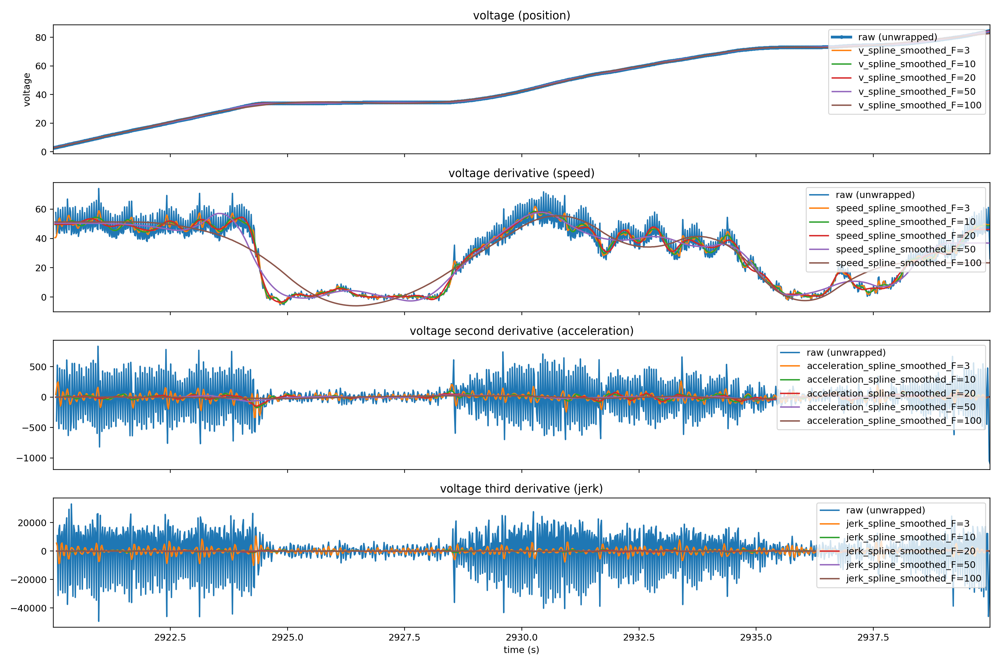

In [14]:
make_visualization(df_sample)

### zoom in on a 1.5 second snippet

<IPython.core.display.Javascript object>


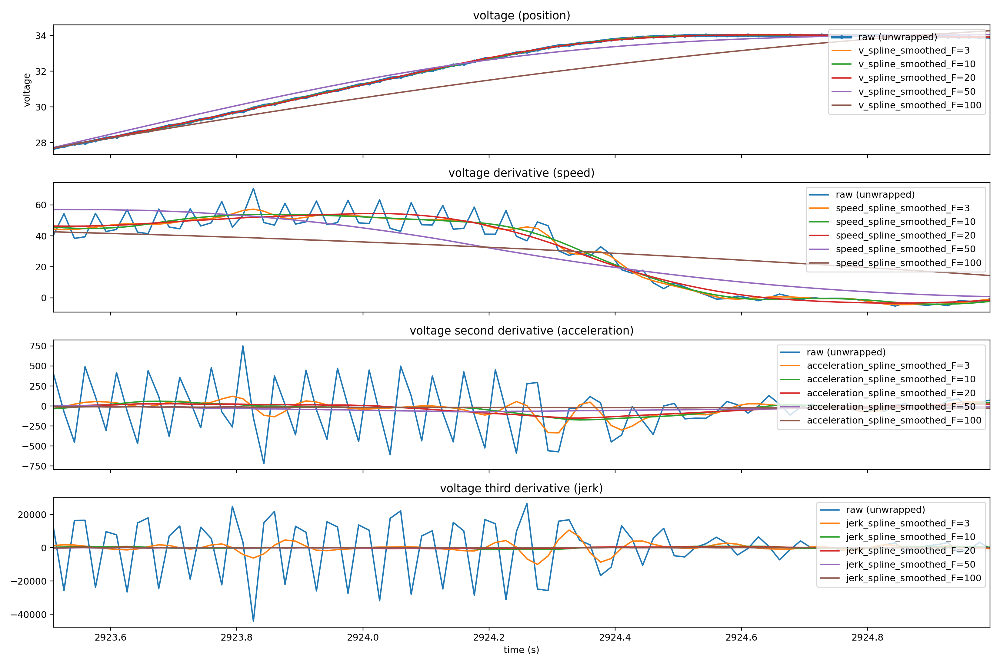

In [15]:
make_visualization(df_sample.query('time >= 2923.5 and time <= 2925.0'))

# Determine the optimal value of `F`

### Some functions for quantifying jerk, a measure of smoothness, one of the factors we wish to minmimize

In [16]:
def mean_squared_jerk(df_in,voltage_col):
    df = df_in.copy()
    df['speed'] = calculate_speed(df, voltage_column=voltage_col)
    df['acceleration'] = calculate_derivative(df, 'speed')
    df['jerk'] = calculate_derivative(df, 'acceleration')
    return np.mean(df['jerk']**2)

def jerk_std(df_in,voltage_col):
    df = df_in.copy()
    df['speed'] = calculate_speed(df, voltage_column=voltage_col)
    df['acceleration'] = calculate_derivative(df, 'speed')
    df['jerk'] = calculate_derivative(df, 'acceleration')
    return np.std(df['jerk'])

def total_jerk(df_in,voltage_col='v_spline_smoothed'):
    df = df_in.copy()
    df['speed'] = calculate_speed(df, voltage_column=voltage_col)
    df['acceleration'] = calculate_derivative(df, 'speed')
    df['jerk'] = calculate_derivative(df, 'acceleration')
    return np.sum(df['jerk'].abs())

def jerk_integral(df_in,voltage_col='v_spline_smoothed'):
    df = df_in.copy()
    df['speed'] = calculate_speed(df, voltage_column=voltage_col)
    df['acceleration'] = calculate_derivative(df, 'speed')
    df['jerk'] = calculate_derivative(df, 'acceleration')
    return np.sum(df['jerk'].abs())

### a function for calculating mean squared error

In [17]:
def mean_squared_error(df_in,col_1,col_2):
    return np.mean((df_in[col_1] - df_in[col_2])**2)

### a function for combining jerk (std) and MSE into a single optimization function that we seek to minimize

In [18]:
def optimization_function(row,k1,k2):
    return k1*row['jerk_std'] + k2*row['mean_squared_error']

### calculate the value of the optimization function for a range of F values

In [19]:
optimization_results = []
df_temp = df_sample.copy()
for F in range(1,100):
    n_knots = len(df_sample)/F
    df_temp['v_spline_smoothed'] = spline_regression(df_temp, col_to_smooth='v_sig_unwrapped', n_knots=n_knots)
    df_temp['speed_spline_smoothed'] = calculate_speed(df_temp, voltage_column='v_spline_smoothed')
    
    optimization_results.append({
        'n_knot_factor':F,
        'n_knots':n_knots,
        'mean_squared_jerk':mean_squared_jerk(df_temp,voltage_col='v_spline_smoothed'),
        'total_jerk':total_jerk(df_temp,voltage_col='v_spline_smoothed'),
        'jerk_std':jerk_std(df_temp,voltage_col='v_spline_smoothed'),
        'mean_squared_error':mean_squared_error(df_temp,'speed_spline_smoothed','speed_raw')
    })
optimization_results = pd.DataFrame(optimization_results)

In [20]:
optimization_results['j'] = optimization_results.apply(optimization_function, axis=1, k1=0.01,k2=1)

### plot the outputs of the optimization function and find the minimum

<IPython.core.display.Javascript object>


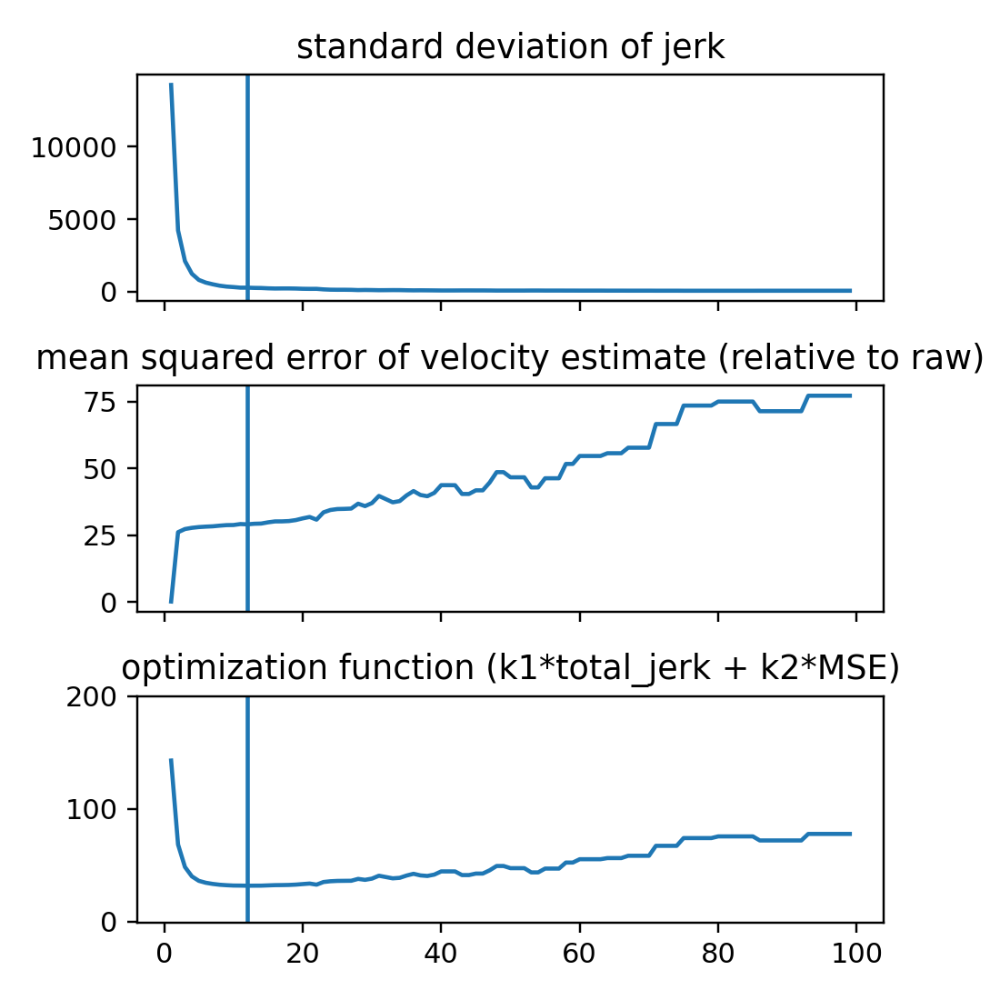

the optimal n_knot factor is 12.0


In [21]:
fig,ax=plt.subplots(3,1,sharex=True,figsize=(5,5))
ax[0].plot(optimization_results['n_knot_factor'],optimization_results['jerk_std'])
ax[1].plot(optimization_results['n_knot_factor'],optimization_results['mean_squared_error'])
ax[2].plot(optimization_results['n_knot_factor'],optimization_results['j'])
ax[2].set_ylim(-1,200)

optimal_index = optimization_results['j'].argmin()
for i in range(3):
    ax[i].axvline(optimization_results.iloc[optimal_index]['n_knot_factor'])
    
ax[0].set_title('standard deviation of jerk')
ax[1].set_title('mean squared error of velocity estimate (relative to raw)')
ax[2].set_title('optimization function (k1*total_jerk + k2*MSE)')
fig.tight_layout()

print('the optimal n_knot factor is {}'.format(optimization_results.iloc[optimal_index]['n_knot_factor']))


## Summaary of optimal F values across sessions
I ran the same optimization function across 250 randomly sampled sessions. The mode of the distribution is at `F = 12`. Sessions with larger optimal F values seem to be those with little to no running (a fairly constant voltage), in which case the jerk component of the cost function dominates, which incentivizes large F values.

In [22]:
conn = db.Database('visual_behavior_data')
collection = conn['behavior_analysis']['running_smoothing']
data = pd.DataFrame(list(collection.find({})))
conn.close()

In [23]:
data.head()

,_id,behavior_session_id,optimal_f,data_sample,optimization_results
0,5f04f3fa39e3a62d76a484a3,892597891,30.0,"[{'time': 300.01509494241327, 'frame': 8054, '...","[{'n_knot_factor': 1, 'n_knots': 7988.0, 'mean..."
1,5f054e8c36ea8974dbcd4cfc,857474527,99.0,"[{'time': 300.0020984619041, 'frame': 9588, 's...","[{'n_knot_factor': 1, 'n_knots': 8993.0, 'mean..."
2,5f054e9e61ecd601d4263804,873805574,99.0,"[{'time': 300.01809159037657, 'frame': 9592, '...","[{'n_knot_factor': 1, 'n_knots': 8992.0, 'mean..."
3,5f054fe4396e547bcf7af5a6,880871827,8.0,"[{'time': 300.0170966568694, 'frame': 8054, 's...","[{'n_knot_factor': 1, 'n_knots': 7992.0, 'mean..."
4,5f0603b3556b3e9f7f2a812f,876821717,24.0,NaN,"[{'n_knot_factor': 1, 'n_knots': 17985.0, 'mea..."


In [24]:
data['optimal_f'].describe()

count    244.000000
mean      25.786885
std       24.650388
min        8.000000
25%       12.000000
50%       15.000000
75%       25.250000
max       99.000000
Name: optimal_f, dtype: float64

<IPython.core.display.Javascript object>


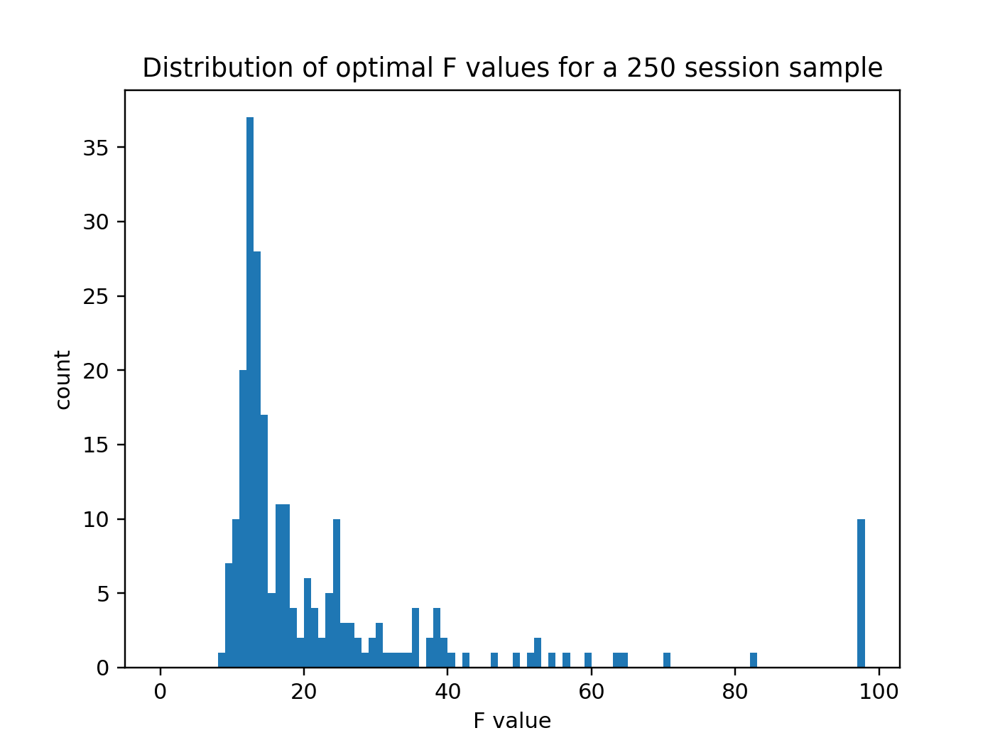

Text(0.5, 1.0, 'Distribution of optimal F values for a 250 session sample')

In [25]:
fig,ax=plt.subplots()
ax.hist(
    data['optimal_f'],
    bins=np.arange(0,99,1)
)
ax.set_xlabel('F value')
ax.set_ylabel('count')
ax.set_title('Distribution of optimal F values for a 250 session sample')

## Look at some of the cached plots for different optimal F values

In [26]:
figure_folder = '/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/running_smoothing/sample_data_figures'

In [27]:
def show_cached_plot(bsid):
    plot_png = os.path.join(figure_folder,'bsid={}.png'.format(bsid))
    im = imageio.imread(plot_png)

    fig,ax = plt.subplots(figsize=(15,12))
    ax.imshow(im)
    fig.tight_layout()

### Here are some examples of sessions for which the optimal F value is 12 (the most common value):
These are sessions with a substantial amount of variability in running speed. F=10 is shown in green and F=20 is shown in red. The optimal fit would fall between these two.

929313608


<IPython.core.display.Javascript object>


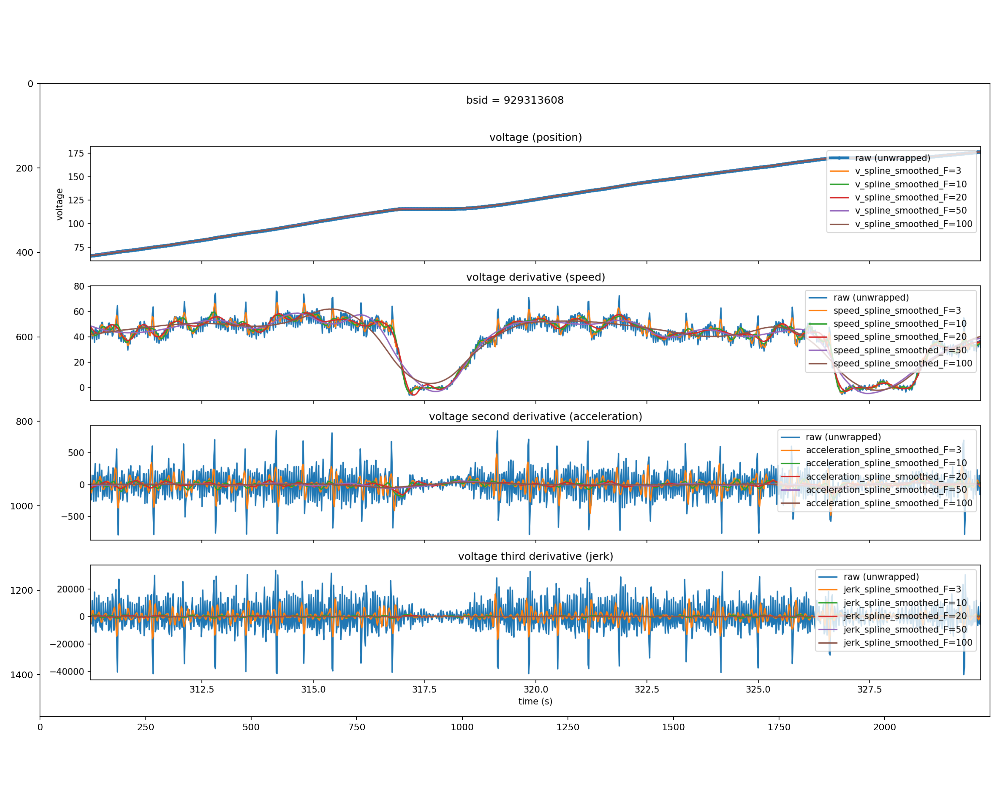

In [28]:
bsid = data.query('optimal_f == 12').iloc[0]['behavior_session_id']
print(bsid)
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


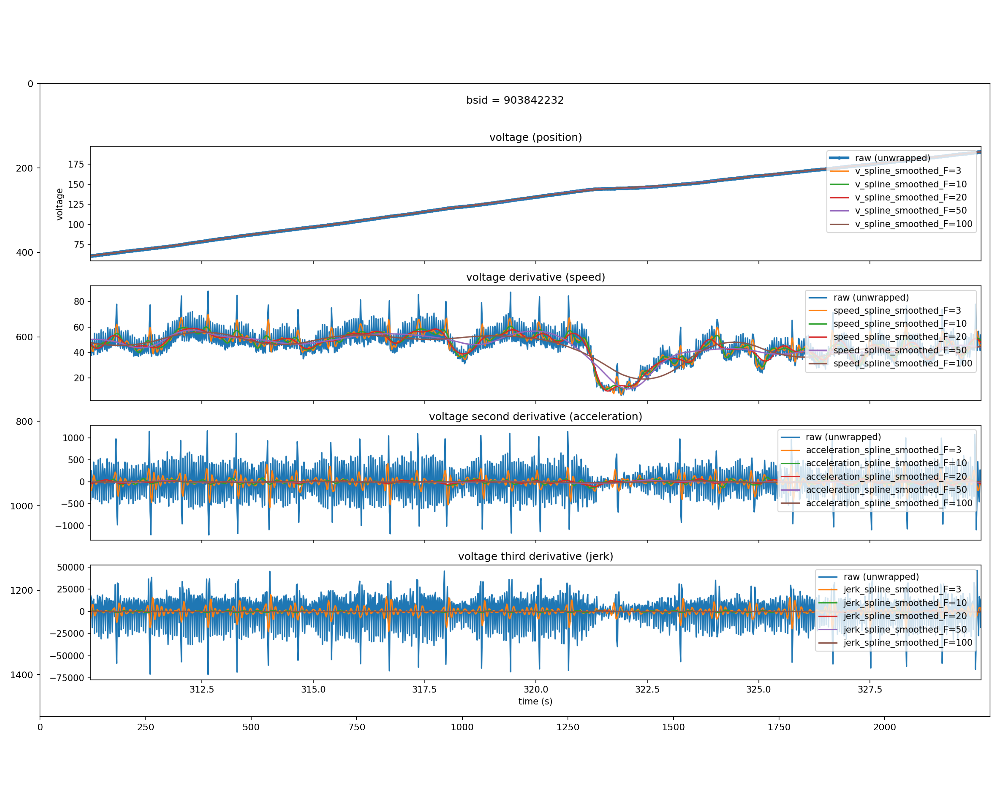

In [29]:
bsid = data.query('optimal_f == 12').iloc[1]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


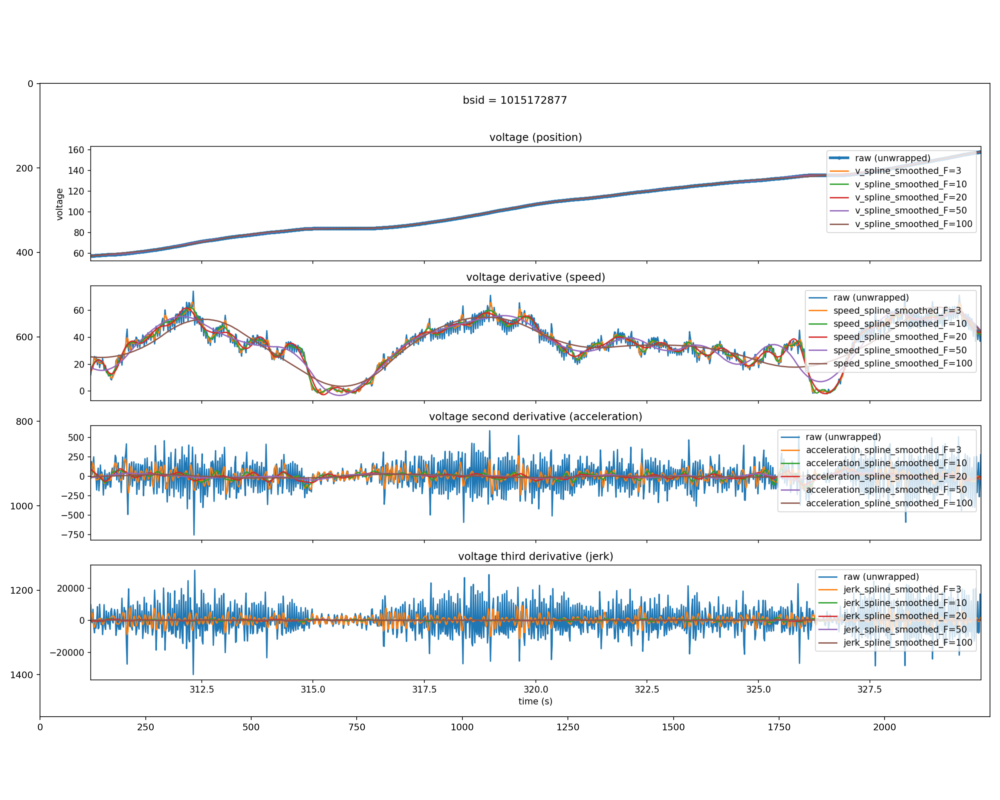

In [30]:
bsid = data.query('optimal_f == 12').iloc[2]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


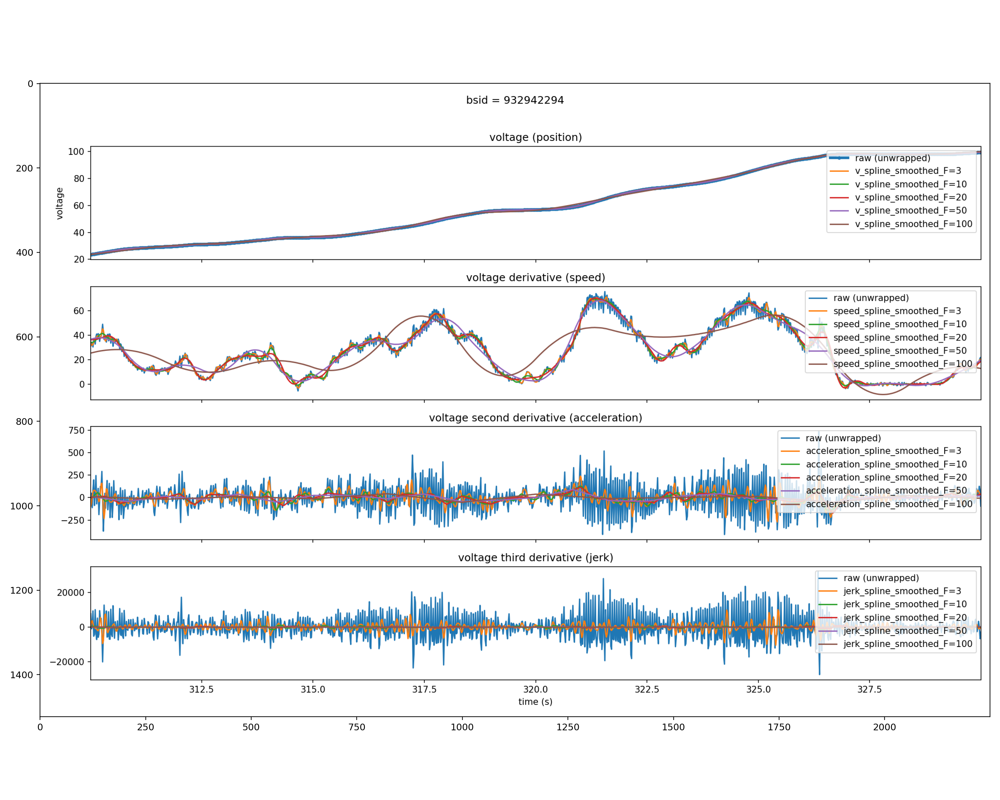

In [31]:
bsid = data.query('optimal_f == 12').iloc[3]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


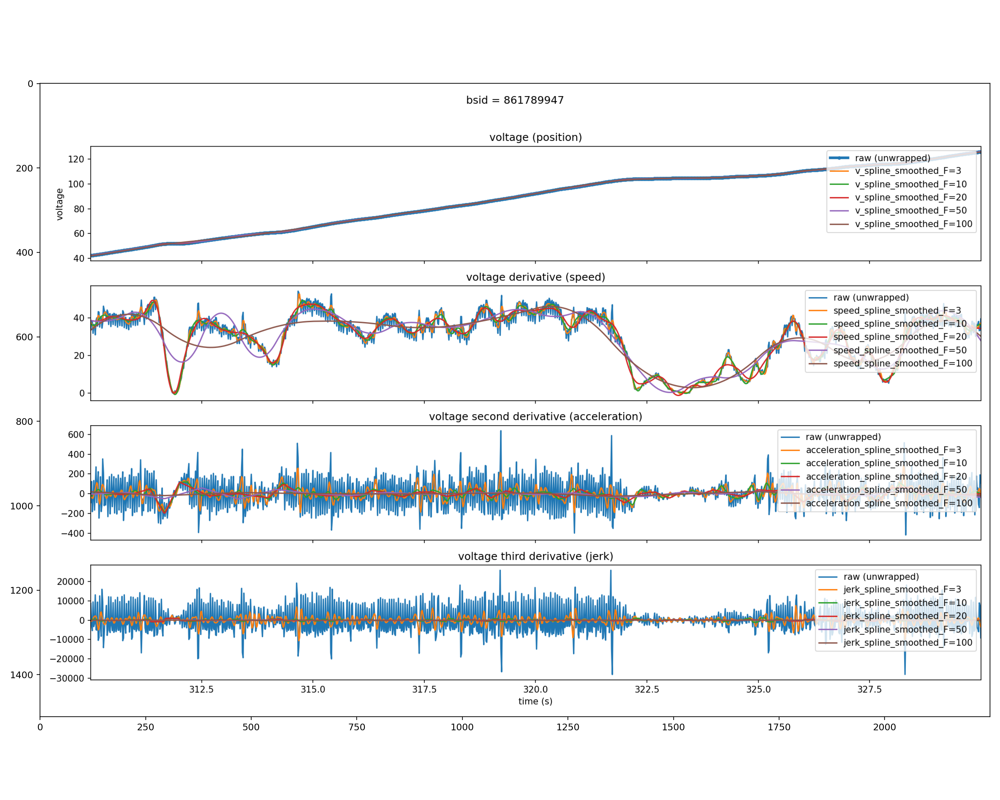

In [32]:
bsid = data.query('optimal_f == 12').iloc[4]['behavior_session_id']
show_cached_plot(bsid)

### Here are some examples of sessions for which the optimal F value is 99:
These are sessions with very little variability in speed (a nearly constant voltage). These could be sessions where the encoder was broken, or where the animal simply remained very still. In either case, the fact that the optimal F value tends toward high values is due to the nature of the optimization function: since the jerk standard deviation monotonically decreases with increasing F (at the limit, for F equal to the number of data points, the fit would be a single 3rd order polynomial with constant jerk), and the MSE will be relatively low even for a poor fit given the constant voltage, the optimal F values will tend to be high.  

<IPython.core.display.Javascript object>


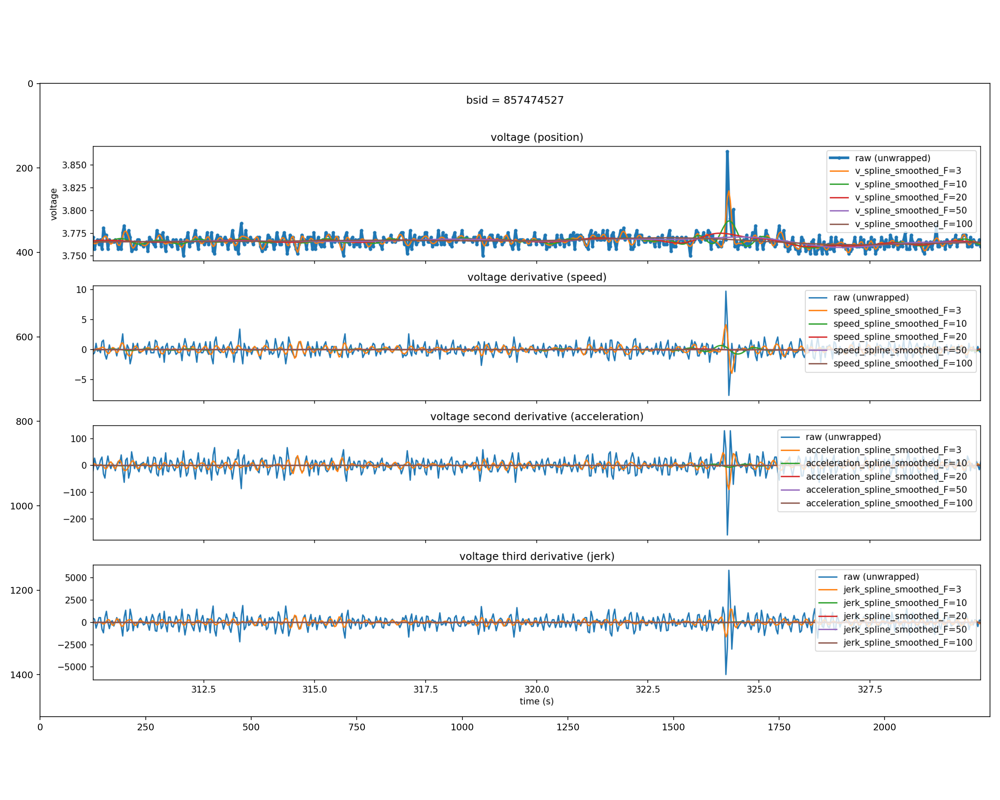

In [33]:
bsid = data.query('optimal_f == 99').iloc[0]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


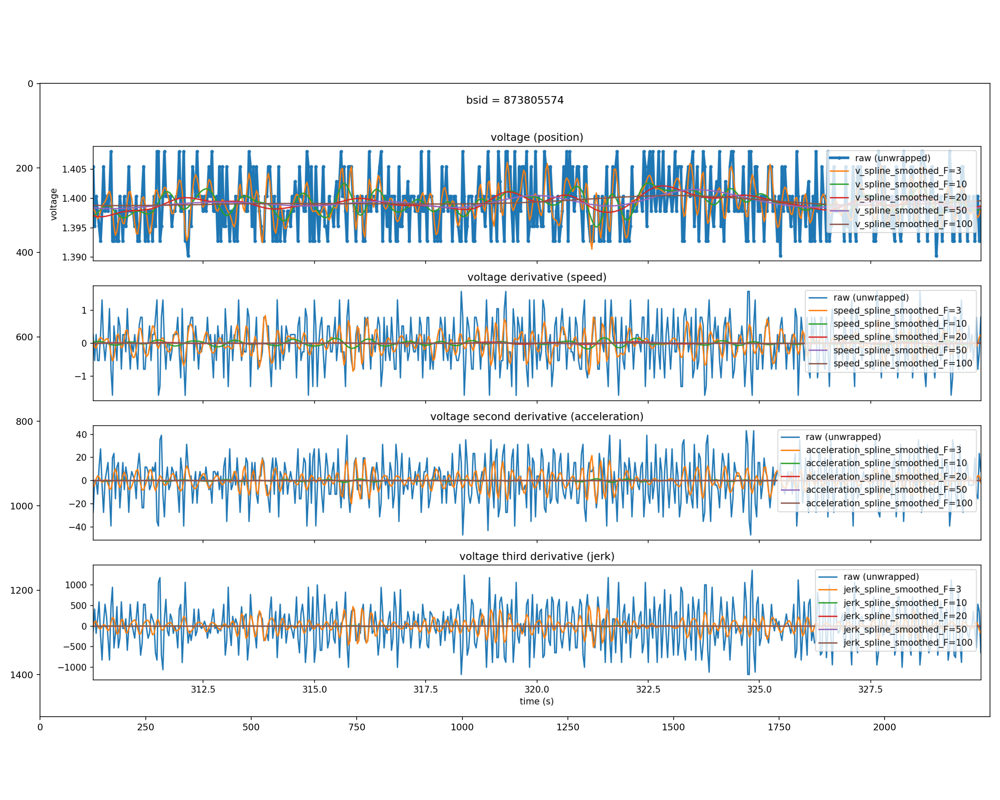

In [34]:
bsid = data.query('optimal_f == 99').iloc[1]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


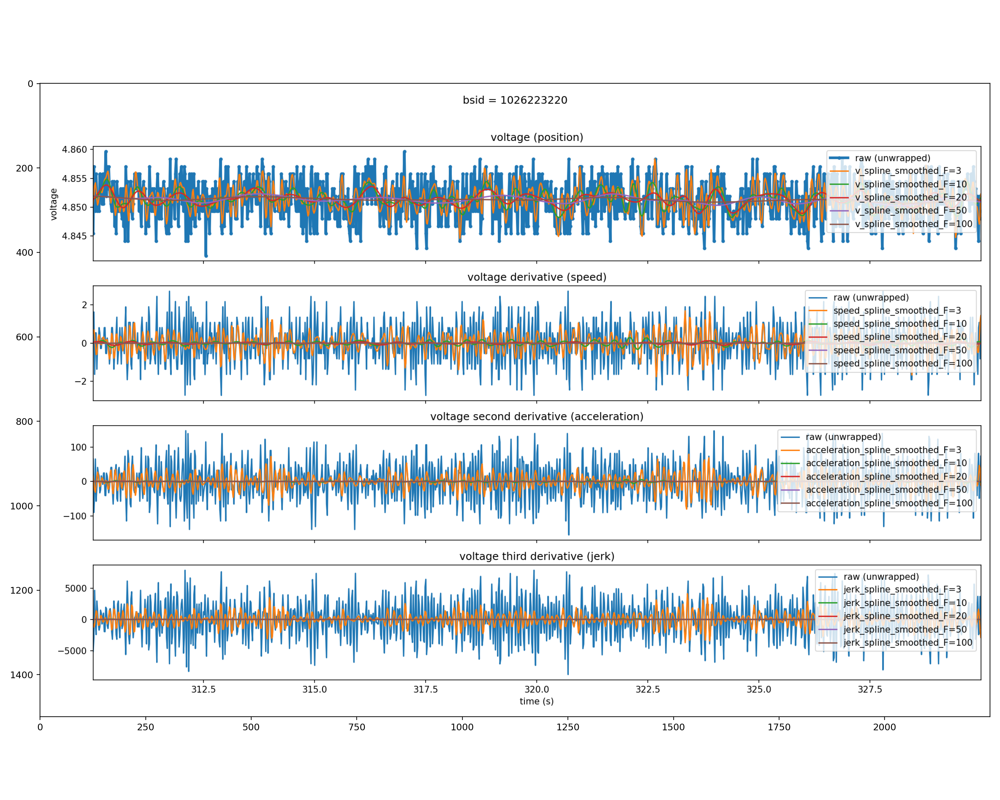

In [35]:
bsid = data.query('optimal_f == 99').iloc[2]['behavior_session_id']
show_cached_plot(bsid)

### Here are some examples of sessions for which the optimal F value is 38 (an intermediate value that was also somewhat commmon):
Much like those sessions for which the optimal F value is 99, these are sessions with little variability in the voltage signal

<IPython.core.display.Javascript object>


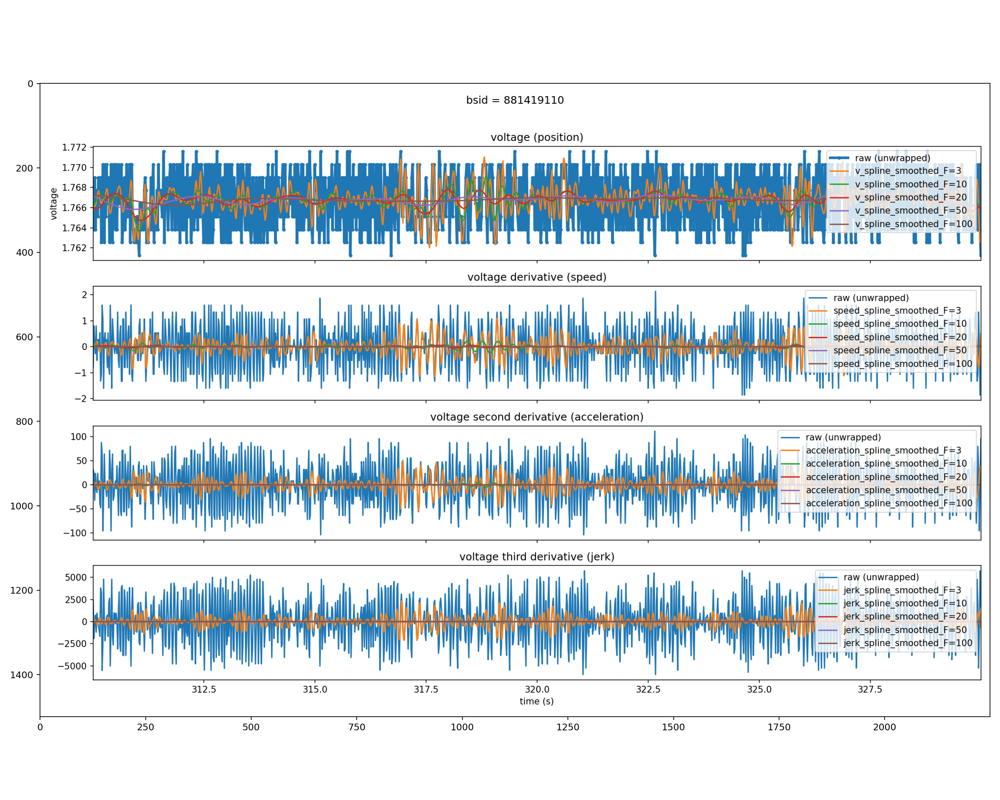

In [36]:
bsid = data.query('optimal_f == 38').iloc[0]['behavior_session_id']
show_cached_plot(bsid)

<IPython.core.display.Javascript object>


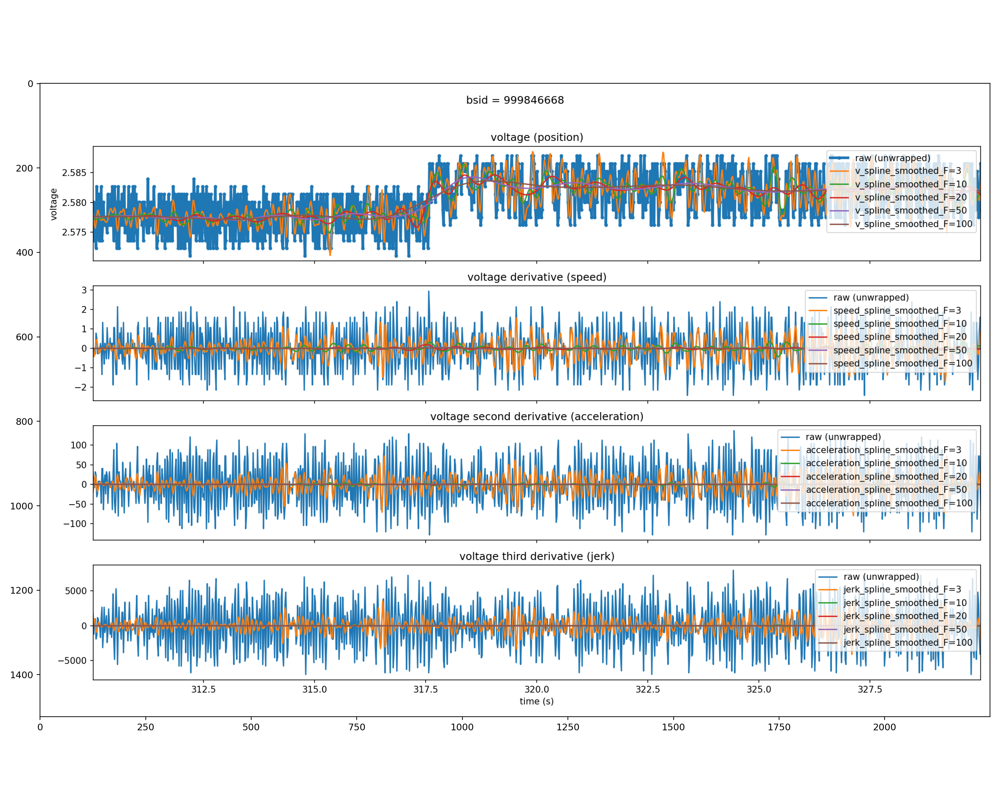

In [37]:
bsid = data.query('optimal_f == 38').iloc[1]['behavior_session_id']
show_cached_plot(bsid)

# CONCLUSION:
Despite the unfortunately high level of noise in the raw encoder voltages, spline regression appears to do a reasonable job of smoothing the voltage measurements and allowing for a more reasonable estimate of the animals' running speeds.

Importantly, spline regression does not impose any unwanted artifacts such as temporal shifting of the signal or attenuation in specific frequency bands.

However, it is important to acknowledge that without a ground truth measurement, we don't truly know how 'good' any smoothing technique truly is. 

Despite this, we can rely on two opposing characteristics of the physical system and the spline fits to justify their use:
* Running is a relatively smooth process. The running wheel itself has inertia, which will minimize the acceleration and jerk (rate of change of acceleration) that the wheel can experience. As the number of knots in the spline fits decrease (increasing F in the convention used here), total jerk will be minimized.
* The noise oscillates around the true voltage value. As the number of knots increases (decreasing F, with F=1 representing a knot at every data point), the spline fits will provide a better fit to the raw data.
Here, we sought to balance these two competing demands to find a number of spline knots that optimized a cost function incorporating both the standard deviation of the jerk and the mean squared error of the fit. While the optimal F value varied somewhat across experiments, the most common value in the sample set was F = 12. This value, therefore, should provide a reasonable fit if aplied to all sessions